## Import the needed libraries

In [2]:
library(PicSureClient)
library(PicSureHpdsLib)

## Create an instance of the datasource adapter and get a reference to the data resource 

In [3]:
adapter <- PicSureHpdsLib::BypassAdapter$new("http://pic-sure-hpds-nhanes:8080/PIC-SURE",FALSE)
resource <- adapter$useResource()

## Get a listing of all "demographics" entries in the data dictionary. Show what actions can be done with the "demographic_results" object

In [4]:
demographic_entries <- resource$dictionary()$find("\\demographics\\")
demographic_entries$help()

No encoding supplied: defaulting to UTF-8.


        [HELP] PicSureHpdsLib$Adapter(connection)$useResource(uuid)$dictionary()$find(term)
            $count()        Returns the number of entries in the dictionary that match the given term
            $keys()         Return the keys of the matching entries
            $entries()      Return a list of matching dictionary entries
            $DataFrame()    Return the entries in a DataFrame-compatible format

        [Examples]
            results = PicSureHpdsLib$Adapter(connection)$useResource(uuid)$dictionary()$find('asthma')
            df = results$DataFrame()


## Examine the demographic_entries results by converting it into a pandas DataFrame

In [5]:
demographic_entries$DataFrame()

,name,min,categorical,observationCount,max,HpdsDataType,categoryValues
1,\demographics\SDDSRVYR\,1,FALSE,41474,4,phenotypes,NA
2,\demographics\INDFMPIR\,0,FALSE,38076,5,phenotypes,NA
3,\demographics\SES_LEVEL\,0,FALSE,38076,2,phenotypes,NA
4,\demographics\SEX\,NA,TRUE,41474,NA,phenotypes,"female,male"
5,\demographics\DMDBORN\,1,FALSE,41445,3,phenotypes,NA
6,\demographics\WTMEC4YR\,0,FALSE,21004,103831.17,phenotypes,NA
7,\demographics\DMDMARTL\,1,FALSE,26793,99,phenotypes,NA
8,\demographics\AGE\,0,FALSE,41474,85,phenotypes,NA
9,\demographics\SDMVPSU\,1,FALSE,41474,3,phenotypes,NA
10,\demographics\RACE\,NA,TRUE,41474,NA,phenotypes,"black,mexican,other,other_hispanic,white"


In [6]:
resource$query()$help()

        $select()   list of data fields to return from resource for each record
        $require()  list of data fields that must be present in all returned records
        $filter()   list of data fields and conditions that returned records satisfy
           [ Filter keys exert an AND relationship on returned records      ]
           [ Categorical values have an OR relationship on their key        ]
           [ Numerical Ranges are inclusive of their start and end points   ]

        $getCount()             returns a count indicating the number of matching numbers
        $getResults()           returns a CSV-like string containing the matching records
        $getResultsDataFrame()  returns a pandas DataFrame containing the matching records
        $getRunDetails()        returns details about the last run of the query
        $getQueryCommand()      returns the JSON-formatted query request
        $show()                 lists all current query parameters

        * $getCount(), 

In [7]:
resource$query()$filter()$help()


            filter()$
              add("key", value)                  - or -
              add("key", "value")               filter to records with KEY column that equals VALUE
              add("key", ["value1", "value2"])  filter to records with KEY column equalling one value within the given list
              add("key", start, end)            filter to records with KEY column value between START and END (inclusive)
                                                    start -or- end may be set to None to filter by a max or min value
              delete("key")                     delete a filter from the list of filters
              show()                            lists all current filters that results records must satisfy
              clear()                           clears all values from the filters list

In [8]:
query_male <- resource$query()
query_male$filter()$add("\\demographics\\SEX\\", list("male"))

query_female <- resource$query()
query_female$filter()$add("\\demographics\\SEX\\", list("female"))

In [9]:
field_age <- resource$dictionary()$find("\\AGE\\")
field_BMI <- resource$dictionary()$find("\\Body Mass Index")

query_male$require()$add(field_age$keys())
query_male$require()$add(field_BMI$keys())
query_female$require()$add(field_age$keys())
query_female$require()$add(field_BMI$keys())

query_female$show()

No encoding supplied: defaulting to UTF-8.
No encoding supplied: defaulting to UTF-8.


{
    "query": {
        "fields": [

        ],
        "requiredFields": [
            "\\demographics\\AGE\\",
            "\\examination\\body measures\\Body Mass Index (kg per m**2)\\"
        ],
        "numericFilters": {

        },
        "categoryFilters": {
            "\\demographics\\SEX\\": [
                "female"
            ]
        },
        "expectedResultType": "DATAFRAME"
    }
}
 


## Convert the query results for females into a DataFrame and plot it by BMI and Age

No encoding supplied: defaulting to UTF-8.


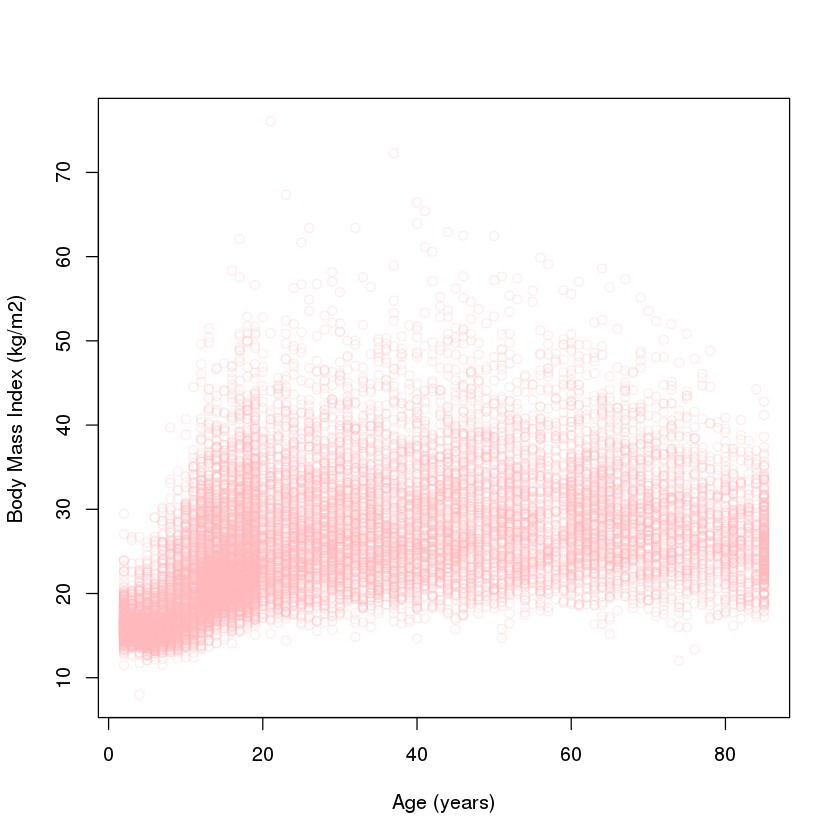

In [10]:
df_f <- query_female$getResultsDataFrame()

# df_f$X.demographics.AGE.
# df_f$X.examination.body.measures.Body.Mass.Index..kg.per.m..2..
plot(
    df_f$X.demographics.AGE., 
    df_f$X.examination.body.measures.Body.Mass.Index..kg.per.m..2..,
    ylab = "Body Mass Index (kg/m2)",
    xlab = "Age (years)",
    col = "#ffbabb40"
)
#plot_f = df_f.plot.scatter(x="\\demographics\\AGE\\", y="\\examination\\body measures\\Body Mass Index (kg per m**2)\\", c="#ffbabb40")

## Convert the query results for males into a DataFrame and plot it by BMI and Age

No encoding supplied: defaulting to UTF-8.


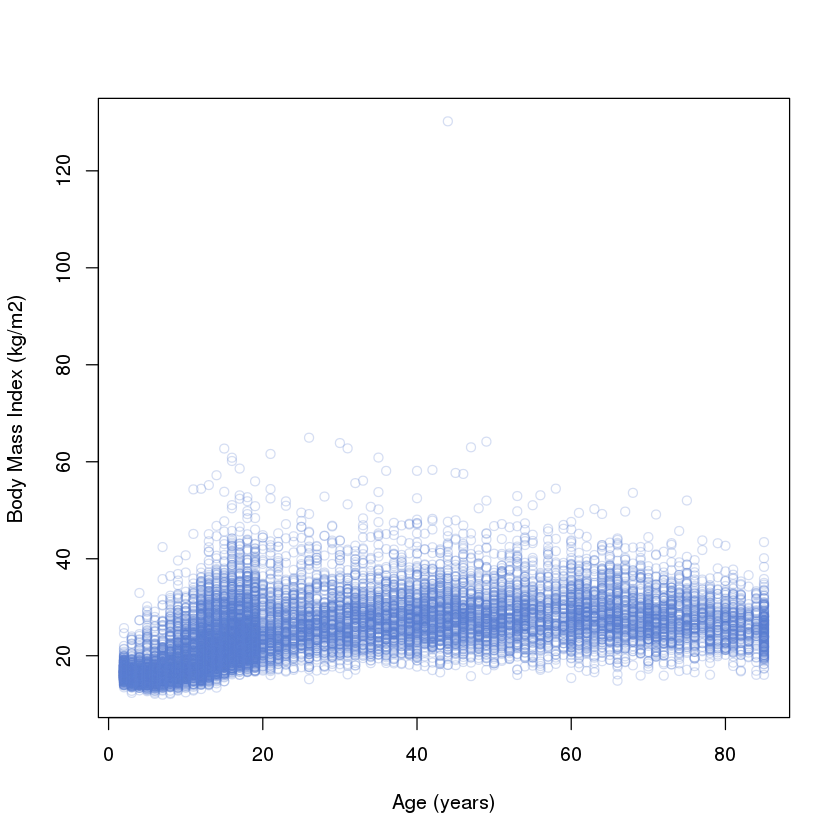

In [11]:
df_m <- query_male$getResultsDataFrame()

plot(
    df_m$X.demographics.AGE., 
    df_m$X.examination.body.measures.Body.Mass.Index..kg.per.m..2..,
    ylab = "Body Mass Index (kg/m2)",
    xlab = "Age (years)",
    col = "#5a7dd040"
)


## Replot the results using a single DataFrame containing both male and female

No encoding supplied: defaulting to UTF-8.
No encoding supplied: defaulting to UTF-8.
No encoding supplied: defaulting to UTF-8.
No encoding supplied: defaulting to UTF-8.


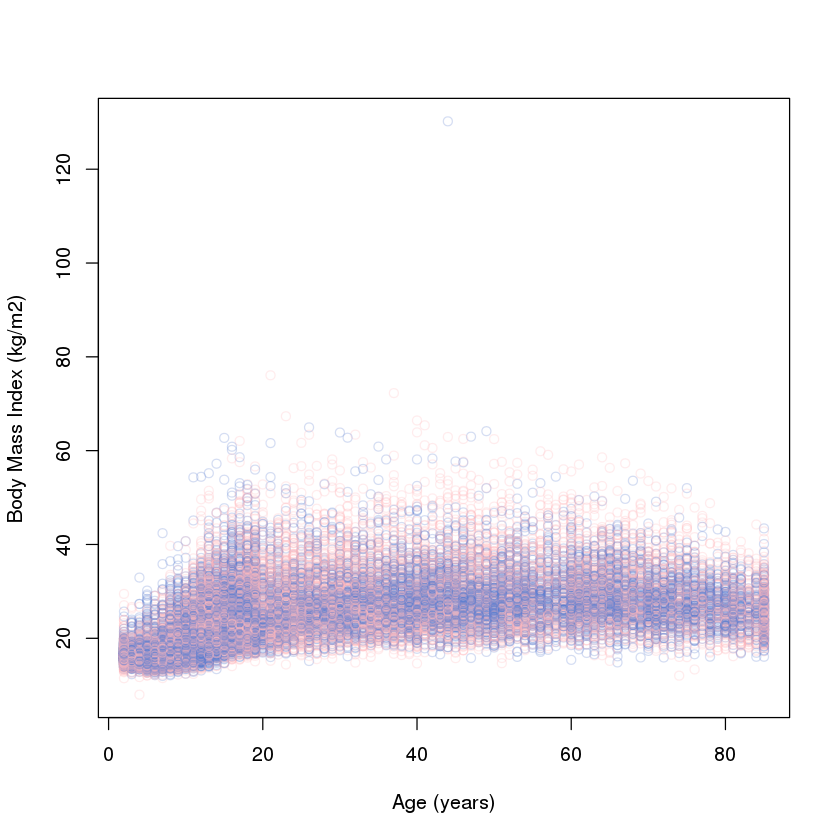

In [12]:
d <- resource$dictionary()
criteria <- list()
criteria <- c(criteria, (d$find("\\SEX\\")$keys()))
criteria <- c(criteria, (d$find("\\Body Mass Index")$keys()))
criteria <- c(criteria, (d$find("\\AGE\\")$keys()))

query_unified <- resource$query()
query_unified$require()$add(criteria)
df_mf = query_unified$getResultsDataFrame()


# map a color field for the plot to use 
df_mf$color="#000000"
df_mf$color[df_mf$X.demographics.SEX.=="female"]="#ffbabb40"
df_mf$color[df_mf$X.demographics.SEX.=="male"]="#5a7dd040"


plot(
    df_mf$X.demographics.AGE., 
    df_mf$X.examination.body.measures.Body.Mass.Index..kg.per.m..2..,
    ylab = "Body Mass Index (kg/m2)",
    xlab = "Age (years)",
    col = df_mf$color
)



## Replot data but trim outliers

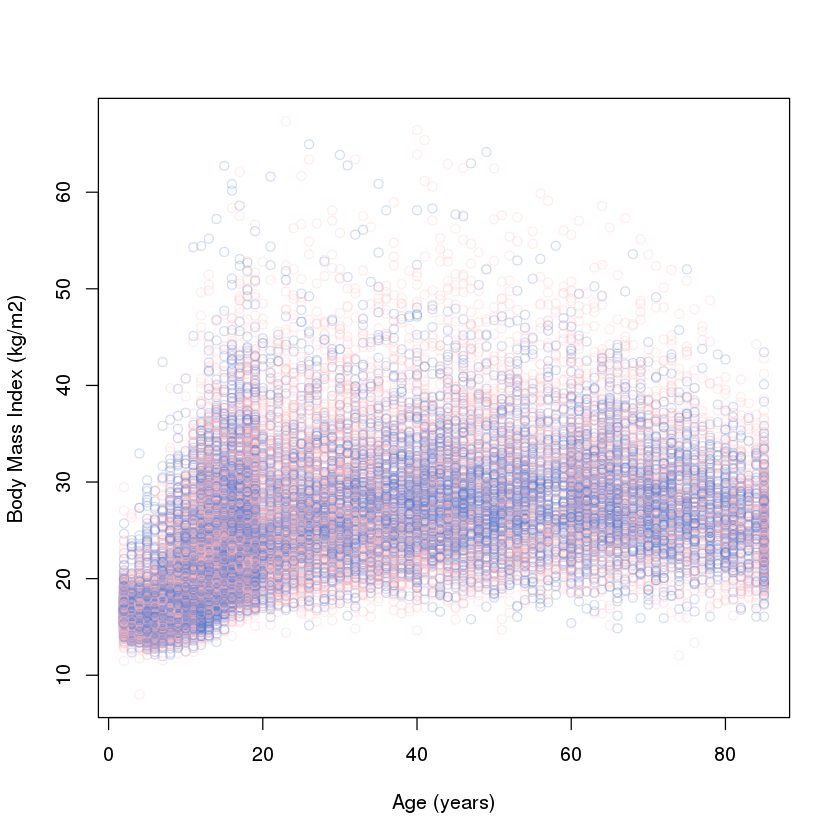

In [13]:
# create a masked array to remove outliers
q <- quantile(df_f$X.examination.body.measures.Body.Mass.Index..kg.per.m..2.., 0.9999)
ma <- (df_mf$X.examination.body.measures.Body.Mass.Index..kg.per.m..2.. <= q)

filtered_mf <- df_mf[ma,]

# plot data
plot(
    filtered_mf$X.demographics.AGE., 
    filtered_mf$X.examination.body.measures.Body.Mass.Index..kg.per.m..2..,
    ylab = "Body Mass Index (kg/m2)",
    xlab = "Age (years)",
    col = filtered_mf$color
)
